In [1]:
from google.colab import drive
drive.mount('/drive')
%cd /drive/My Drive/tutorials

Drive already mounted at /drive; to attempt to forcibly remount, call drive.mount("/drive", force_remount=True).
/drive/My Drive/tutorials


In [0]:
import torch
import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

import matplotlib.pyplot as plt
import numpy as np
import random

In [0]:
transform = transforms.Compose(
    [transforms.ToTensor(),
    #transforms.Normalize((0.5,),(0.5,)),
     ]# if color image, then transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5)
)

In [4]:
PATH = './data'
batch_size =256
workers = 2
epochs = 250
image_size=28*28
latent_size=100
label_size=10
fixed_input_size = 8*label_size 

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

manualSeed = 3734
print("Random Seed: ",manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  3734


In [0]:
train_set = torchvision.datasets.MNIST(root=PATH,train=True,
                                      download=True,transform=transform)
train_loader = torch.utils.data.DataLoader(train_set,batch_size=batch_size,
                                          shuffle =True, num_workers=workers)

test_set = torchvision.datasets.MNIST(root=PATH,train=False,
                                     download=True, transform=transform)

test_loader = torch.utils.data.DataLoader(test_set, batch_size=batch_size,
                                          shuffle = False, num_workers=workers)

train_iter = iter(train_loader)
test_iter = iter(test_loader)

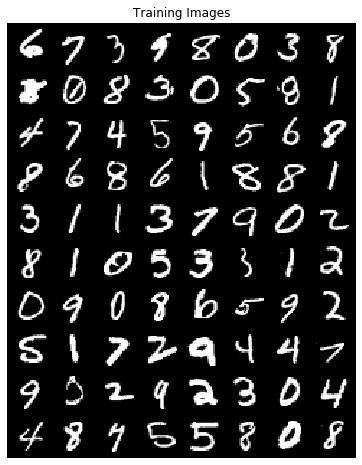

In [6]:
real_batch, labels = next(iter(train_loader))
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch.to(device)[:80],padding=2,normalize=False).cpu(),(1,2,0)))

In [7]:
real_batch.size()

torch.Size([256, 1, 28, 28])

In [0]:
import torch.nn as nn
import torch.nn.functional as F

class G(nn.Module):
  def __init__(self):
    super(G,self).__init__()
    self.net=nn.Sequential(
        nn.Linear(latent_size+label_size,256),
        nn.ReLU(),
        nn.Linear(256,256),
        nn.ReLU(),
        nn.Linear(256, image_size),
        nn.Tanh()
    )

  def forward(self, z):
    z=self.net(z)
    return z

In [0]:
class D(nn.Module):
  def __init__(self):
    super(D,self).__init__()
    self.net=nn.Sequential(
        nn.Linear(image_size+label_size,256),
        nn.LeakyReLU(0.2),
        nn.Linear(256,256),
        nn.LeakyReLU(0.2),
        nn.Linear(256,1),
        nn.Sigmoid()
    )
  def forward(self, x):
    x=self.net(x)
    return x

In [0]:
import torch.optim as optim

G_net = G().to(device)
D_net = D().to(device)

criterion = nn.BCELoss()
G_optimizer = optim.Adam(G_net.parameters(),lr=0.0002,betas=(0.5,0.999))
D_optimizer = optim.Adam(D_net.parameters(),lr=0.0002,betas=(0.5,0.999))

real_label = 1
fake_label = 0


fixed_noise = torch.randn(label_size*8, latent_size,device=device)
labels =torch.zeros(label_size*8,label_size,device=device)
for j in range(8):
  for i in range(10):
    labels[i*8+j][i]=1
fixed_inputs=torch.cat((fixed_noise,labels),1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


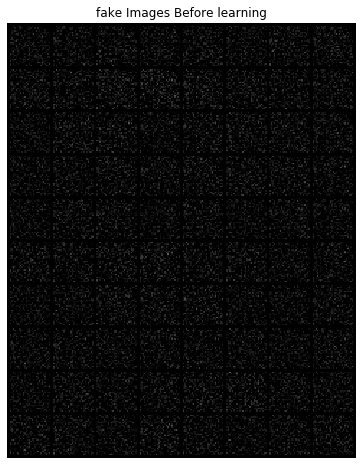

In [11]:
with torch.no_grad():
  fake_batch=G_net(fixed_inputs)
plt.figure(figsize=(8,8))
plt.axis('off')
plt.title('fake Images Before learning')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device).view(80,1,28,28),padding=2,normalize=False).cpu(),(1,2,0)))

In [12]:
one_hot_labels=torch.zeros(batch_size,label_size)
labs=torch.randint(9,size=(batch_size,1))
print(one_hot_labels.size(), labs.size())
print(labs[:10])

torch.Size([256, 10]) torch.Size([256, 1])
tensor([[8],
        [0],
        [5],
        [1],
        [0],
        [1],
        [8],
        [7],
        [1],
        [4]])


In [13]:
one_hot_labels.scatter_(1,labs,1)

tensor([[0., 0., 0.,  ..., 0., 1., 0.],
        [1., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 1., 0.,  ..., 0., 0., 0.],
        [1., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 1.,  ..., 0., 0., 0.]])

In [14]:
img_list = []
G_losses = []
D_losses = []
for ep in range(epochs):
  for i, (data, labels) in enumerate(train_loader):
    b_size=data.shape[0] # last batch != batch_size

    data = data.reshape(b_size,-1).to(device)
    labels=labels.view(-1,1).to(device)
    one_hot_labels = torch.zeros(b_size,label_size,device=device) # 128 * 10
    one_hot_labels.scatter_(1,labels,1)
    real_labeled_data=torch.cat((data,one_hot_labels),1)

    real_labels = torch.ones(b_size,1).to(device)
    fake_labels = torch.zeros(b_size,1).to(device)


    #Train D
    D_net.zero_grad()

    real_score = Dx = D_net(real_labeled_data)
    loss_Dx = criterion(Dx, real_labels)

    z = torch.randn(b_size,latent_size).to(device)
    labeled_z=torch.cat((z,one_hot_labels),1)
    Gz = G_net(labeled_z)
    Gz = torch.cat((Gz,one_hot_labels),1)
    fake_score = DGz = D_net(Gz.detach())

    loss_DGz = criterion(DGz,fake_labels)

    loss_D = loss_Dx  + loss_DGz
    loss_D.backward()
    D_optimizer.step()

    #Train G
    G_net.zero_grad()
    DGz = D_net(Gz)
    
    loss_G = criterion(DGz, real_labels)

    loss_G.backward()
    G_optimizer.step()

    if (i+1)%200 == 0 or i==0:
      print('Epoch [{}/{}], Step [{}/{}], d_loss: {:.4f}, g_loss: {:.4f}, D(x): {:.2f}, D(G(z)): {:.2f}' 
            .format(ep, epochs, i+1, len(train_loader), loss_D.item(), loss_G.item(), 
                    real_score.mean().item(), fake_score.mean().item()))
      if i==0:
        G_losses.append(loss_G.item())
        D_losses.append(loss_D.item())
      with torch.no_grad():
        fake = G_net(fixed_inputs).detach().cpu()
        img_list.append(vutils.make_grid(torch.reshape(fake,(80,1,28,28)), padding=2, normalize=False))

Epoch [0/250], Step [1/235], d_loss: 1.3787, g_loss: 0.6737, D(x): 0.52, D(G(z)): 0.51
Epoch [0/250], Step [200/235], d_loss: 0.9521, g_loss: 1.0915, D(x): 0.69, D(G(z)): 0.43
Epoch [1/250], Step [1/235], d_loss: 0.6045, g_loss: 1.5988, D(x): 0.85, D(G(z)): 0.35
Epoch [1/250], Step [200/235], d_loss: 0.3325, g_loss: 4.5942, D(x): 0.88, D(G(z)): 0.14
Epoch [2/250], Step [1/235], d_loss: 0.3727, g_loss: 4.5823, D(x): 0.89, D(G(z)): 0.17
Epoch [2/250], Step [200/235], d_loss: 0.1616, g_loss: 4.3719, D(x): 0.94, D(G(z)): 0.06
Epoch [3/250], Step [1/235], d_loss: 0.3769, g_loss: 3.5359, D(x): 0.82, D(G(z)): 0.08
Epoch [3/250], Step [200/235], d_loss: 0.1803, g_loss: 4.2315, D(x): 0.92, D(G(z)): 0.06
Epoch [4/250], Step [1/235], d_loss: 0.2521, g_loss: 4.5374, D(x): 0.90, D(G(z)): 0.05
Epoch [4/250], Step [200/235], d_loss: 0.2332, g_loss: 4.9961, D(x): 0.94, D(G(z)): 0.13
Epoch [5/250], Step [1/235], d_loss: 0.1836, g_loss: 4.6331, D(x): 0.95, D(G(z)): 0.11
Epoch [5/250], Step [200/235], d_

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


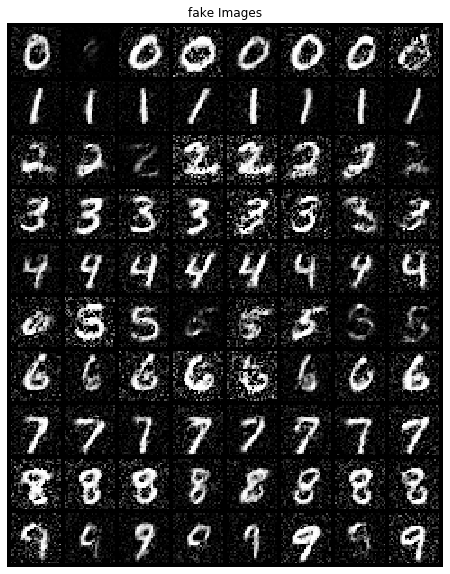

In [15]:
with torch.no_grad():
  fake_batch=G_net(fixed_inputs)
plt.figure(figsize=(8,10))
plt.axis('off')
plt.title('fake Images')
plt.imshow(np.transpose(vutils.make_grid(fake_batch.to(device).view(80,1,28,28),padding=2, normalize=False).cpu(),(1,2,0)))

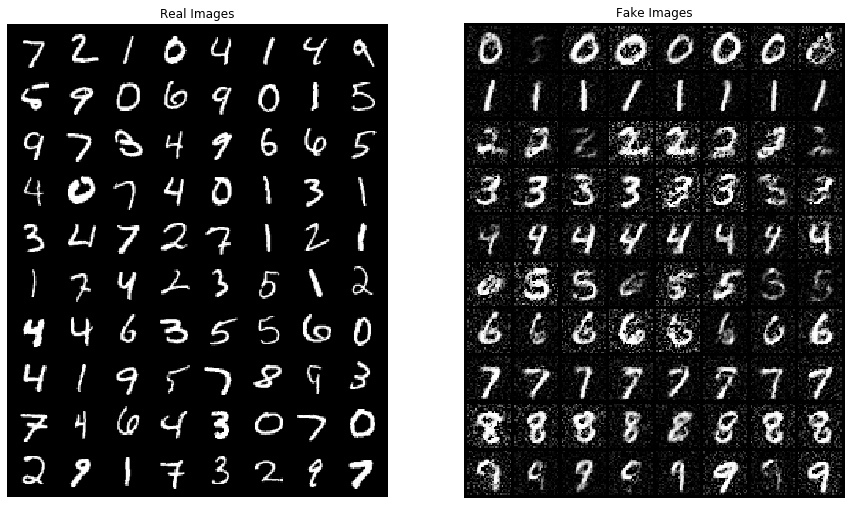

In [16]:
real_batch = next(iter(test_loader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:80], padding=5,normalize=False).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)).clamp(0,1))
plt.show()

Animation size has reached 21072353 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


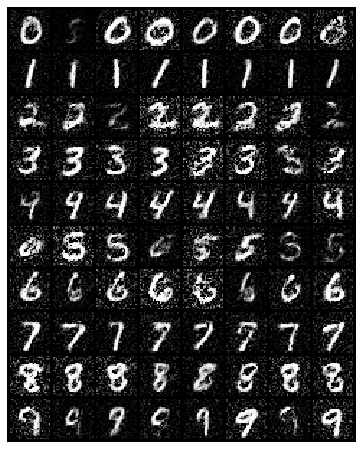

In [17]:
import matplotlib
import matplotlib.animation as animation
from IPython.display import HTML
fig = plt.figure(figsize=(8,8))
plt.axis("off")

ims = [[plt.imshow(np.transpose(i,(1,2,0)).clamp_(0,1), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [0]:
from PIL import Image
transform_PIL=transforms.ToPILImage()
p_img_list = [transform_PIL(p_image.clamp_(0,1)) for p_image in img_list]
p_img_list[0].save('CGAN_mnist.gif', save_all=True,append_images=p_img_list[1:], optimize=False, duration=1, loop=0)

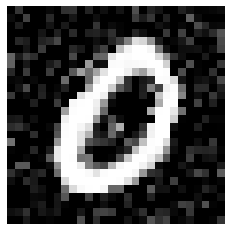

In [19]:
with torch.no_grad():
  random_noise=torch.randn(latent_size,device=device)
  random_input = torch.cat((random_noise,torch.tensor([1,0,0,0,0,0,0,0,0,0],dtype=torch.float,device=device)))
  fake=G_net(random_input)

fake_image = fake.reshape(28,28).cpu()
fake_image=torch.clamp(fake_image,0,1)
plt.axis("off")
plt.imshow(fake_image,cmap='gray')

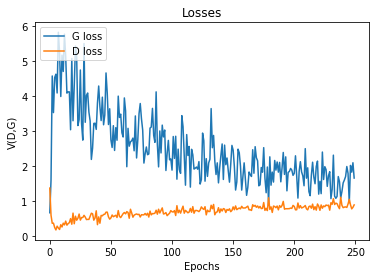

In [20]:
plt.title("Losses")
plt.plot(G_losses,label="G loss")
plt.plot(D_losses,label="D loss")
plt.legend(loc=2)
plt.ylabel("V(D,G)")
plt.xlabel("Epochs")
plt.show()